# Financial Planning with APIs and Simulations

In [198]:
# Import libraries and dependencies
import os
import requests
import json
import pandas as pd
from dotenv import load_dotenv
import alpaca_trade_api as tradeapi
from MCForecastTools import MCSimulation

%matplotlib inline

In [199]:
# Load .env
load_dotenv()

True

## Part 1: Create a Financial Planner for Emergencies

### Evaluate the Cryptocurrency Wallet by Using the Requests Library

In [200]:
# Number of cryto assets held
btc_coins = 1.2
eth_coins = 5.3

In [201]:
# Monthly income
monthly_income = 12000

In [202]:
# Set endpoint URLs for API
btc_url = "https://api.alternative.me/v2/ticker/Bitcoin/?convert=USD"
eth_url = "https://api.alternative.me/v2/ticker/Ethereum/?convert=USD"

In [203]:
# API call for BTC
btc_response = requests.get(btc_url).json()

# Printing and formatting response using json dumps
print(json.dumps(btc_response, indent=3, sort_keys=True))


{
   "data": {
      "1": {
         "circulating_supply": 19045206,
         "id": 1,
         "last_updated": 1653092955,
         "max_supply": 21000000,
         "name": "Bitcoin",
         "quotes": {
            "USD": {
               "market_cap": 558012999683,
               "percent_change_1h": -0.0857241182828107,
               "percent_change_24h": -3.05842994260744,
               "percent_change_7d": 0.0132514256735766,
               "percentage_change_1h": -0.0857241182828107,
               "percentage_change_24h": -3.05842994260744,
               "percentage_change_7d": 0.0132514256735766,
               "price": 29315.0,
               "volume_24h": 25443313419
            }
         },
         "rank": 1,
         "symbol": "BTC",
         "total_supply": 19045206,
         "website_slug": "bitcoin"
      }
   },
   "metadata": {
      "error": null,
      "num_cryptocurrencies": 3106,
      "timestamp": 1653092955
   }
}


In [204]:
# API call for ETH
eth_response = requests.get(eth_url).json()

# Printing and formatting response using json dumps
print(json.dumps(eth_response, indent=3, sort_keys=True))

{
   "data": {
      "1027": {
         "circulating_supply": 120859606,
         "id": 1027,
         "last_updated": 1653092902,
         "max_supply": 0,
         "name": "Ethereum",
         "quotes": {
            "USD": {
               "market_cap": 237761734236,
               "percent_change_1h": -0.217291619216501,
               "percent_change_24h": -2.22444687565105,
               "percent_change_7d": -2.13700981813595,
               "percentage_change_1h": -0.217291619216501,
               "percentage_change_24h": -2.22444687565105,
               "percentage_change_7d": -2.13700981813595,
               "price": 1967.26,
               "volume_24h": 14501371447
            }
         },
         "rank": 2,
         "symbol": "ETH",
         "total_supply": 120859606,
         "website_slug": "ethereum"
      }
   },
   "metadata": {
      "error": null,
      "num_cryptocurrencies": 3106,
      "timestamp": 1653092902
   }
}


In [205]:
# Accessing BTC price from response
btc_price = btc_response['data']['1']['quotes']['USD']['price']
print(btc_price)


29315.0


In [206]:
# Accessing ETH price from response
eth_price = eth_response['data']['1027']['quotes']['USD']['price']
print(eth_price)


1967.26


In [207]:
# Compute current BTC holding value
btc_value = btc_price * btc_coins
print(btc_value)


35178.0


In [208]:
# Compute current ETH holding value
eth_value = eth_price * eth_coins
print(eth_value)


10426.478


In [209]:
# Compute total crypto currency value
total_crypto_wallet = btc_value + eth_value
print(total_crypto_wallet)


45604.478


### Evaluate the Stock and Bond Holdings by Using the Alpaca SDK

In [210]:
# Number of stock/bond assets set
spy_shares = 110
agg_shares = 200


In [211]:
# Variables for alpaca API
alpaca_api_key = os.getenv('ALPACA_API_KEY')
alpaca_secret_key = os.getenv('ALPACA_SECRET_KEY')

#Alpaca tradeapi.REST object
alpaca = tradeapi.REST(
    alpaca_api_key,
    alpaca_secret_key,
    api_version='v2'

)


In [212]:
# Tickers for stock and bond portfolio
tickers = ['SPY', 'AGG']

# Timeframe for API request
timeframe = '1Day'

# Set start and end dates for API request
start_date = pd.Timestamp('2022-05-18', tz='America/New_York').isoformat()
end_date = pd.Timestamp('2022-05-18', tz='America/New_York').isoformat()


In [213]:
# Creating a datafram from Alpaca API data request
prices_df = alpaca.get_bars(
    tickers,
    timeframe,
    start = start_date,
    end = end_date,
    limit=10000
).df

# Reorganizing dataframe and viewing 5 rows
SPY = prices_df[prices_df['symbol']=='SPY'].drop('symbol', axis=1)
AGG = prices_df[prices_df['symbol']=='AGG'].drop('symbol', axis=1)
prices_df = pd.concat([SPY, AGG], axis=1, keys=['SPY', 'AGG'])
prices_df.head()



SPY                                    \
                             open   high     low   close     volume   
timestamp                                                             
2022-05-18 04:00:00+00:00  403.52  403.8  390.55  391.86  117208507   

                                                      AGG                    \
                          trade_count        vwap    open     high      low   
timestamp                                                                     
2022-05-18 04:00:00+00:00      962719  396.040647  102.11  102.639  102.075   

                                                                   
                            close   volume trade_count       vwap  
timestamp                                                          
2022-05-18 04:00:00+00:00  102.59  6091812       20134  102.49456

In [214]:
# Accessing closing price for AGG
agg_close_price = float(prices_df['AGG']['close'])
print(agg_close_price)


102.59


In [215]:
# Accessing clsoing price for SPY
spy_close_price = float(prices_df['SPY']['close'])
print(spy_close_price)


391.86


In [216]:
# Total value of AGG holdings
agg_value = agg_close_price * agg_shares
print(agg_value)


20518.0


In [217]:
# Total value of SPY holdings
spy_value = spy_close_price * spy_shares
print(spy_value)


43104.6


In [218]:
# Total value of stock and bond portfolio
total_stocks_bonds = agg_value + spy_value
print(total_stocks_bonds)


63622.6


In [219]:
# Calculating total stock/bond and crypto portfolio value
total_portfolio = total_crypto_wallet + total_stocks_bonds
print(total_portfolio)


109227.07800000001


### Evaluate the Emergency Fund

In [220]:
# List of financial assets
savings_data = [total_crypto_wallet, total_stocks_bonds]
savings_data    

[45604.478, 63622.6]

In [221]:
# Creating dataframe of assets using previous list
savings_df = pd.DataFrame(savings_data, columns=['Amount'], index=['crypto', 'stock/bond'])
savings_df


,Amount
crypto,45604.478
stock/bond,63622.600


<AxesSubplot:title={'center':'Portfolio Distribution'}, ylabel='Amount'>

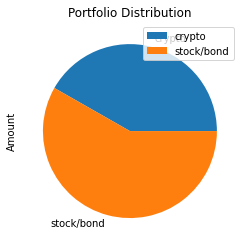

In [222]:
# Pie chart displaying portfolio split
savings_df.plot.pie(y='Amount', title='Portfolio Distribution')


In [223]:
# Creating emergency fund variable
emergency_fund_value = 3 * monthly_income


In [224]:
# if-else statement that evaluates portfolio fund
if total_portfolio > emergency_fund_value:
    print('Congratualations, you have enough money in your fund')
elif total_portfolio == emergency_fund_value:
    print('Congratulations on reaching this important financial goal')
else:
    print(f'You are currently ${round(emergency_fund_value - total_portfolio)} away from reaching your goal')

Congratualations, you have enough money in your fund


## Part 2: Create a Financial Planner for Retirement

### Create the Monte Carlo Simulation

In [225]:
# Setting start date, end date, and row limit for Monte Carlo Simulation
start_date = pd.Timestamp('2019-05-19', tz='America/New_York').isoformat()
end_date = pd.Timestamp('2022-05-19', tz='America/New_York').isoformat()
row_limit = 10000

In [226]:
# Creating dataframe from alpaca API request
mc_data_df = alpaca.get_bars(
    tickers,
    timeframe,
    start=start_date,
    end= end_date,
    limit=row_limit

).df
# Reorganizing and displaying dataframe
SPY = mc_data_df[mc_data_df['symbol']=='SPY'].drop('symbol', axis=1)
AGG = mc_data_df[mc_data_df['symbol']=='AGG'].drop('symbol', axis=1)
mc_data_df = pd.concat([SPY, AGG], axis=1, keys=['SPY', 'AGG'])
display(mc_data_df.head())
display(mc_data_df.tail())


SPY                                     \
                             open     high     low   close    volume   
timestamp                                                              
2019-05-20 04:00:00+00:00  284.06  285.962  283.12  283.95  63153446   
2019-05-21 04:00:00+00:00  285.83  286.930  285.55  286.51  47390688   
2019-05-22 04:00:00+00:00  285.43  286.690  285.10  285.63  49717083   
2019-05-23 04:00:00+00:00  283.16  283.210  280.57  282.14  99142377   
2019-05-24 04:00:00+00:00  283.75  284.200  282.09  282.78  57468147   

                                                      AGG                    \
                          trade_count        vwap    open      high     low   
timestamp                                                                     
2019-05-20 04:00:00+00:00      344197  284.223615  108.98  109.0568  108.86   
2019-05-21 04:00:00+00:00      256169  286.268748  108.86  108.9100  108.81   
2019-05-22 04:00:00+00:00      260143  285.783071  108.92  109.0900  108.92   
2019-05-23 04:00:00+00:00      466151  281.947377  109.18  109.5000  109.14   
2019-05-24 04:00:00+00:00      267403  283.004360  109.37  109.4499  109.33   

                                                                    
                            close   volume trade_count        vwap  
timestamp                                                           
2019-05-20 04:00:00+00:00  108.88  2035081        9880  108.929741  
2019-05-21 04:00:00+00:00  108.87  2029825       10303  108.866734  
2019-05-22 04:00:00+00:00  109.05  3509876       16272  109.052999  
2019-05-23 04:00:00+00:00  109.37  4922489       21453  109.375381  
2019-05-24 04:00:00+00:00  109.41  2010339        9636  109.398082

SPY                                       \
                             open    high       low   close     volume   
timestamp                                                                
2022-05-13 04:00:00+00:00  396.73  403.18  395.6100  401.72  103901082   
2022-05-16 04:00:00+00:00  400.04  403.97  397.6000  400.09   78874575   
2022-05-17 04:00:00+00:00  406.51  408.55  402.5824  408.26   80507900   
2022-05-18 04:00:00+00:00  403.52  403.80  390.5500  391.86  117208507   
2022-05-19 04:00:00+00:00  388.62  394.14  387.1100  389.46   99692078   

                                                      AGG                    \
                          trade_count        vwap    open     high      low   
timestamp                                                                     
2022-05-13 04:00:00+00:00      855050  399.875308  102.75  102.780  102.480   
2022-05-16 04:00:00+00:00      731213  400.635833  102.71  102.970  102.690   
2022-05-17 04:00:00+00:00      737208  405.686032  102.27  102.430  102.140   
2022-05-18 04:00:00+00:00      962719  396.040647  102.11  102.639  102.075   
2022-05-19 04:00:00+00:00      933248  390.337739  103.20  103.220  102.750   

                                                                     
                            close    volume trade_count        vwap  
timestamp                                                            
2022-05-13 04:00:00+00:00  102.51   6701432       26730  102.590449  
2022-05-16 04:00:00+00:00  102.74   7238402       23197  102.788078  
2022-05-17 04:00:00+00:00  102.18   6604743       28112  102.269471  
2022-05-18 04:00:00+00:00  102.59   6091812       20134  102.494560  
2022-05-19 04:00:00+00:00  102.85  10245597       35420  102.908813

In [227]:
# Configuring Monte Carlo simulation of 500 samples over 30 years using a 60/40 porfolio
mc_sim_60_40 = MCSimulation(
    portfolio_data=mc_data_df,
    weights=[.6,.4],
    num_simulation=500,
    num_trading_days=252*30
)

# Reviewing the simulation data
mc_sim_60_40.portfolio_data.head()


SPY                                     \
                             open     high     low   close    volume   
timestamp                                                              
2019-05-20 04:00:00+00:00  284.06  285.962  283.12  283.95  63153446   
2019-05-21 04:00:00+00:00  285.83  286.930  285.55  286.51  47390688   
2019-05-22 04:00:00+00:00  285.43  286.690  285.10  285.63  49717083   
2019-05-23 04:00:00+00:00  283.16  283.210  280.57  282.14  99142377   
2019-05-24 04:00:00+00:00  283.75  284.200  282.09  282.78  57468147   

                                                                   AGG  \
                          trade_count        vwap daily_return    open   
timestamp                                                                
2019-05-20 04:00:00+00:00      344197  284.223615          NaN  108.98   
2019-05-21 04:00:00+00:00      256169  286.268748     0.009016  108.86   
2019-05-22 04:00:00+00:00      260143  285.783071    -0.003071  108.92   
2019-05-23 04:00:00+00:00      466151  281.947377    -0.012219  109.18   
2019-05-24 04:00:00+00:00      267403  283.004360     0.002268  109.37   

                                                                          \
                               high     low   close   volume trade_count   
timestamp                                                                  
2019-05-20 04:00:00+00:00  109.0568  108.86  108.88  2035081        9880   
2019-05-21 04:00:00+00:00  108.9100  108.81  108.87  2029825       10303   
2019-05-22 04:00:00+00:00  109.0900  108.92  109.05  3509876       16272   
2019-05-23 04:00:00+00:00  109.5000  109.14  109.37  4922489       21453   
2019-05-24 04:00:00+00:00  109.4499  109.33  109.41  2010339        9636   

                                                    
                                 vwap daily_return  
timestamp                                           
2019-05-20 04:00:00+00:00  108.929741          NaN  
2019-05-21 04:00:00+00:00  108.866734    -0.000092  
2019-05-22 04:00:00+00:00  109.052999     0.001653  
2019-05-23 04:00:00+00:00  109.375381     0.002934  
2019-05-24 04:00:00+00:00  109.398082     0.000366

In [228]:
# Running Monte Carlo Simulation
mc_sim_60_40.calc_cumulative_return();


Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.


c:\Users\magey\Desktop\Fintech-Workspace\Module 5 Challenge\Challenge5\MCForecastTools.py:117: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  portfolio_cumulative_returns[n] = (1 + sim_df.fillna(0)).cumprod()


Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.
Running Monte Carlo simulation number 200.
Running Monte Carlo simulation number 210.
Running Monte Carlo simulation number 220.
Running Monte Carlo simulation number 230.
Running Monte Carlo simulation number 240.
Running Monte Carlo simulation number 250.
Running Monte Carlo simulation number 260.
Running Monte Carlo simulation number 270.
Running Monte Carlo simulation number 280.
Running Monte Carlo simulation number 290.
Running Monte Carlo simulation number 300.
Running Monte Carlo simulation number 310.
Running Monte Carlo simulation number 320.
Running Monte Carlo simulation number 330.
Running Mon

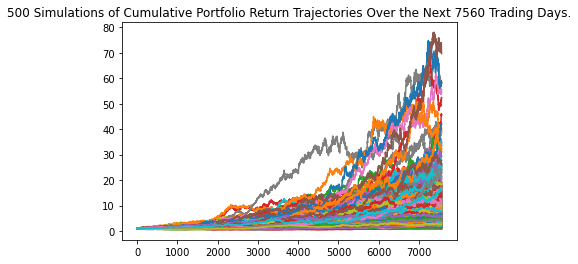

In [229]:
# Plotting 30 year Monte Carlo Simulation
mc_sim_60_40_plot = mc_sim_60_40.plot_simulation()


#### Step 3: Plot the probability distribution of the Monte Carlo simulation.

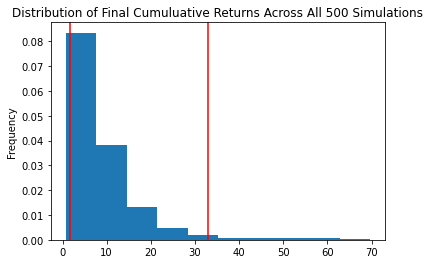

In [230]:
# Plotting distribution of simulation
mc_sim_60_40_distribution = mc_sim_60_40.plot_distribution()


#### Step 4: Generate the summary statistics for the Monte Carlo simulation.

In [231]:
# Generating and view simulation statistics
mc_sim_60_40_statistics = mc_sim_60_40.summarize_cumulative_return()
mc_sim_60_40_statistics

count           500.000000
mean              9.156654
std               8.530454
min               0.722625
25%               4.106357
50%               6.635819
75%              11.105402
max              69.672310
95% CI Lower      1.593350
95% CI Upper     33.021103
Name: 7560, dtype: float64

### Analyze the Retirement Portfolio Forecasts

In [232]:
# Print the current balance of the stock and bond portion of the members portfolio
print(f'Current stock and bond value: ${total_stocks_bonds}')


Current stock and bond value: $63622.6


In [233]:
# Calculating range of possible outcomes using 95% confidence 
ci_lower_thirty_cumulative_return = round(mc_sim_60_40_statistics[8]*total_stocks_bonds,2)
ci_upper_thirty_cumulative_return = round(mc_sim_60_40_statistics[9]*total_stocks_bonds,2)
print(f'There is 95% chance that the members 30 year 60/40 split portfolio will fall between ${ci_lower_thirty_cumulative_return} and ${ci_upper_thirty_cumulative_return} in the next 30 years')


There is 95% chance that the members 30 year 60/40 split portfolio will fall between $101373.06 and $2100888.43 in the next 30 years


### Forecast Cumulative Returns in 10 Years

In [234]:
# Configuring Monte Carlo simulation of 500 samples over 10 years using a 80/20 porfolio
mc_sim_80_20 = MCSimulation(
    portfolio_data=mc_data_df,
    weights=[.8,.2],
    num_simulation=500,
    num_trading_days=252*10
)

# Reviewing simulation data
mc_sim_80_20.portfolio_data.head()

SPY                                     \
                             open     high     low   close    volume   
timestamp                                                              
2019-05-20 04:00:00+00:00  284.06  285.962  283.12  283.95  63153446   
2019-05-21 04:00:00+00:00  285.83  286.930  285.55  286.51  47390688   
2019-05-22 04:00:00+00:00  285.43  286.690  285.10  285.63  49717083   
2019-05-23 04:00:00+00:00  283.16  283.210  280.57  282.14  99142377   
2019-05-24 04:00:00+00:00  283.75  284.200  282.09  282.78  57468147   

                                                                   AGG  \
                          trade_count        vwap daily_return    open   
timestamp                                                                
2019-05-20 04:00:00+00:00      344197  284.223615          NaN  108.98   
2019-05-21 04:00:00+00:00      256169  286.268748     0.009016  108.86   
2019-05-22 04:00:00+00:00      260143  285.783071    -0.003071  108.92   
2019-05-23 04:00:00+00:00      466151  281.947377    -0.012219  109.18   
2019-05-24 04:00:00+00:00      267403  283.004360     0.002268  109.37   

                                                                          \
                               high     low   close   volume trade_count   
timestamp                                                                  
2019-05-20 04:00:00+00:00  109.0568  108.86  108.88  2035081        9880   
2019-05-21 04:00:00+00:00  108.9100  108.81  108.87  2029825       10303   
2019-05-22 04:00:00+00:00  109.0900  108.92  109.05  3509876       16272   
2019-05-23 04:00:00+00:00  109.5000  109.14  109.37  4922489       21453   
2019-05-24 04:00:00+00:00  109.4499  109.33  109.41  2010339        9636   

                                                    
                                 vwap daily_return  
timestamp                                           
2019-05-20 04:00:00+00:00  108.929741          NaN  
2019-05-21 04:00:00+00:00  108.866734    -0.000092  
2019-05-22 04:00:00+00:00  109.052999     0.001653  
2019-05-23 04:00:00+00:00  109.375381     0.002934  
2019-05-24 04:00:00+00:00  109.398082     0.000366

In [235]:
# Running the Monte Carlo simulation
mc_sim_80_20.calc_cumulative_return();


Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.


c:\Users\magey\Desktop\Fintech-Workspace\Module 5 Challenge\Challenge5\MCForecastTools.py:117: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  portfolio_cumulative_returns[n] = (1 + sim_df.fillna(0)).cumprod()


Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.
Running Monte Carlo simulation number 200.
Running Monte Carlo simulation number 210.
Running Monte Carlo simulation number 220.
Running Monte Carlo simulation number 230.
Running Monte Carlo simulation number 240.
Running Monte Carlo simulation number 250.
Running Monte Carlo simulation number 260.
Running Monte Carlo simulation number 270.
Running Monte Carlo simulation number 280.
Running Monte Carlo simulation number 290.
Running Monte Carlo simulation number 300.
Running Monte Carlo simulation number 310.
Running Monte Carlo simulation number 320.
Running Monte Carlo simulation number 330.
Running Mon

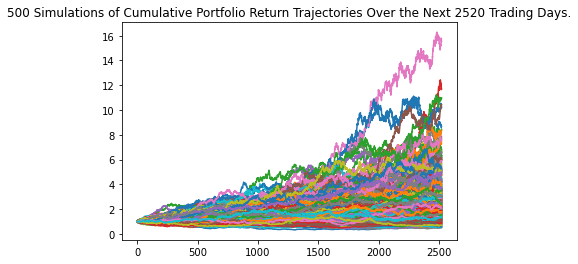

In [236]:
# PLotting simulation
mc_sim_80_20_plot = mc_sim_80_20.plot_simulation()


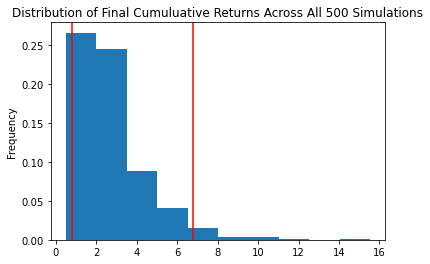

In [237]:
# PLotting simulation distribution
mc_sim_80_20_distribution = mc_sim_80_20.plot_distribution()


In [238]:
# Generating simulation statistics
mc_sim_80_20_statistics = mc_sim_80_20.summarize_cumulative_return()
mc_sim_80_20_statistics

count           500.000000
mean              2.751980
std               1.771795
min               0.491597
25%               1.635498
50%               2.336658
75%               3.390722
max              15.540289
95% CI Lower      0.775138
95% CI Upper      6.770043
Name: 2520, dtype: float64

### Answer the following questions:

#### Question: Using the current value of only the stock and bond portion of the member's portfolio and the summary statistics that you generated from the new Monte Carlo simulation, what are the lower and upper bounds for the expected value of the portfolio (with the new weights) with a 95% confidence interval?

In [239]:
# Print the current balance of the stock and bond portion of the members portfolio
print(f'Current stock and bond value: ${total_stocks_bonds}')


Current stock and bond value: $63622.6


In [240]:
# Calculating range of possible outcomes using 95% confidence 
ci_lower_ten_cumulative_return = round(mc_sim_80_20_statistics[8]*total_stocks_bonds,2)
ci_upper_ten_cumulative_return = round(mc_sim_80_20_statistics[9]*total_stocks_bonds,2)
print(f'There is 95% chance that the members 10 year 80/20 split portfolio will fall between ${ci_lower_ten_cumulative_return} and ${ci_upper_ten_cumulative_return} in the next 30 years')


There is 95% chance that the members 10 year 80/20 split portfolio will fall between $49316.33 and $430727.76 in the next 30 years


#### Question: Will weighting the portfolio more heavily to stocks allow the credit union members to retire after only 10 years?

**Answer** I do not believe that weighing the portfolio more to stocks would allow the members to retire to retire quickly due the returns of the 10 year simulation resulting in less than a third of the 30 year simulation. Based off of this, a more balanced would result in a better return.

